In [34]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [35]:
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import mean_squared_error

In [36]:
def fun(img_name, sigma):
    #cv2.setUseOptimized(True)

    img_gold = cv2.imread(img_name)
    img = img_gold + np.random.normal(scale=sigma,
                                size=img_gold.shape)
    img = np.clip(img, 0, 255)  # we might get out of bounds due to noise
    img = np.uint8(img)

    e1 = cv2.getTickCount()

    #dst = cv2.fastNlMeansDenoisingColored(img,None,2*np.sqrt(sigma),np.sqrt(sigma),7,21)
    dst = cv2.fastNlMeansDenoisingColored(img,None,10,10,7,18 + int(np.sqrt(sigma)))

    #for iter in range(int(np.round(sigma//10,0)) - 1):
    #    dst = cv2.fastNlMeansDenoisingColored(dst,None,10,10,7,21)
    e2 = cv2.getTickCount()
    time = (e2 - e1) / cv2.getTickFrequency()
    print("The Processing time of the NlMeansDenoising is %f s" % time)

    return img_gold, img, dst

In [37]:
def PSNR2(img1, img2):
    D = np.array(img2, dtype=np.int64) - np.array(img1, dtype=np.int64)
    D = D**2
    RMSE = D.sum()/img1.size
    psnr = 10*np.log10(float(255.**2)/RMSE)
    return psnr

In [38]:
def make_plot(img_gold, noise_img, Final_img, sigma):

    plt.figure(figsize=(16, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(img_gold, cv2.COLOR_BGR2RGB))
    plt.title('Original image')

    plt.subplot(1, 3, 2)
    plt.imshow(cv2.cvtColor(noise_img, cv2.COLOR_BGR2RGB))
    plt.title('Noisy image, sigma = ' + str(sigma))

    psnr = PSNR2(img_gold, Final_img)
    s = ssim(img_gold, Final_img, data_range=Final_img.max()-img_gold.min(), multichannel=True)

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(Final_img, cv2.COLOR_BGR2RGB))
    plt.title('Final image, psnr = '+str(psnr.round(2))+', ssim = '+str(s.round(3)))

The Processing time of the NlMeansDenoising is 1.354375 s
The Processing time of the NlMeansDenoising is 1.398224 s
The Processing time of the NlMeansDenoising is 1.381301 s
The Processing time of the NlMeansDenoising is 1.641170 s
The Processing time of the NlMeansDenoising is 1.616619 s
The Processing time of the NlMeansDenoising is 1.650932 s
The Processing time of the NlMeansDenoising is 1.933603 s
The Processing time of the NlMeansDenoising is 1.910540 s
The Processing time of the NlMeansDenoising is 1.905510 s
The Processing time of the NlMeansDenoising is 2.192066 s


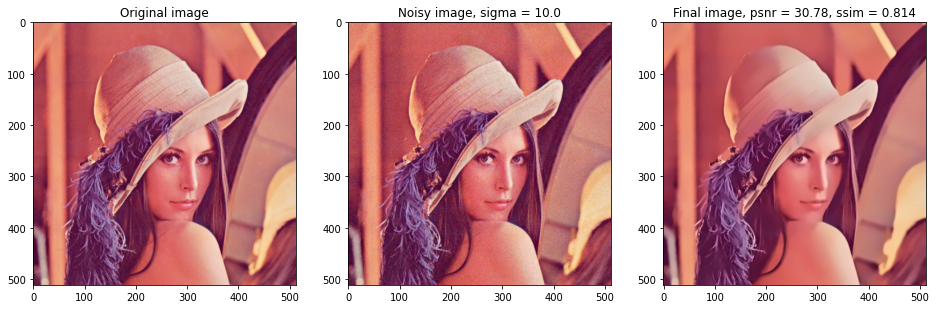

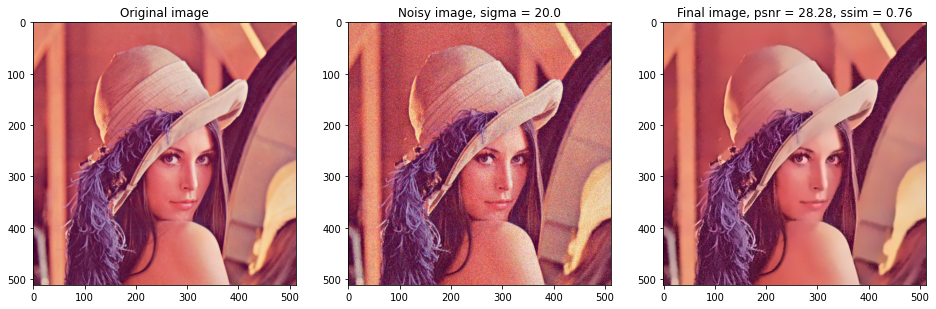

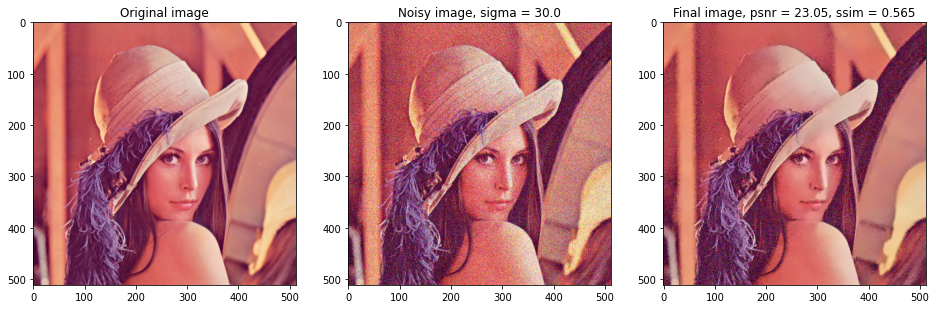

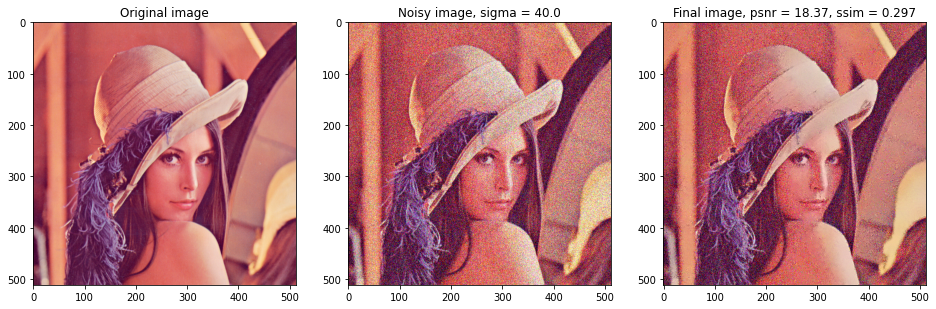

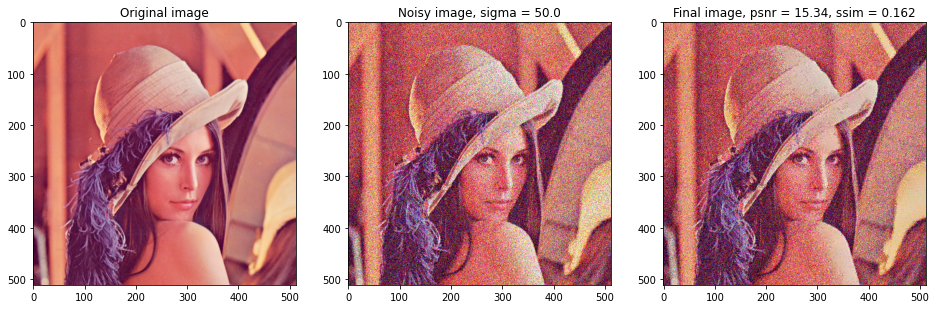

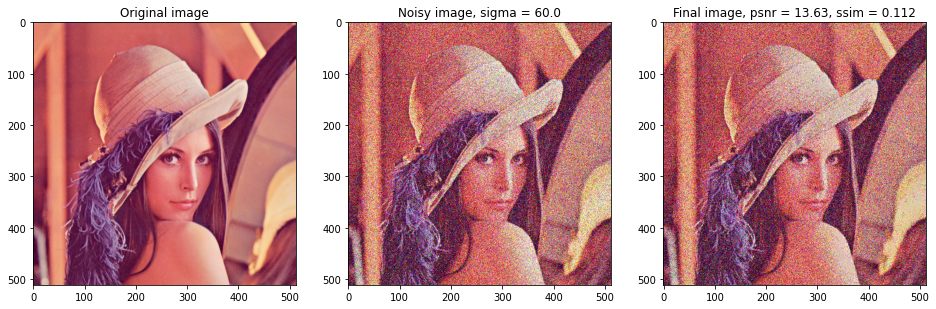

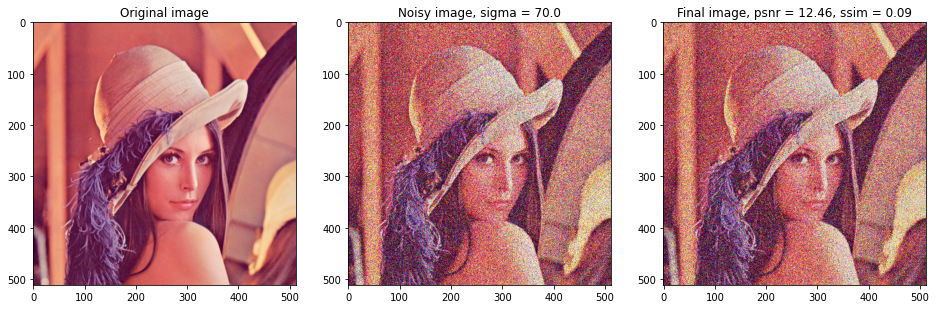

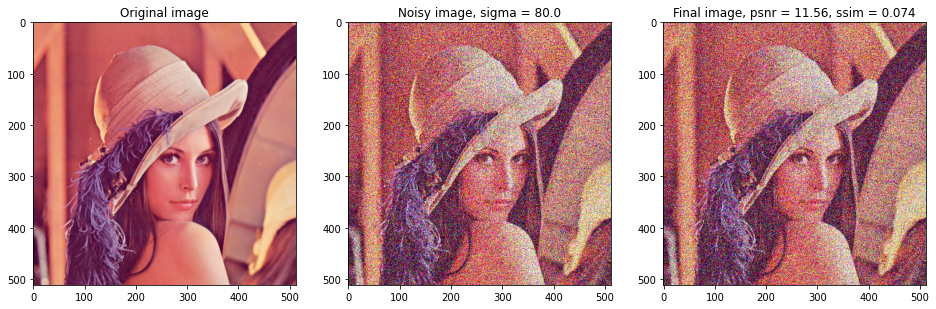

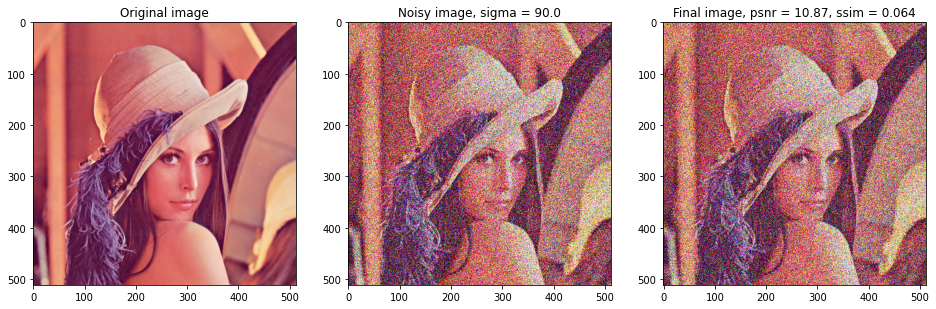

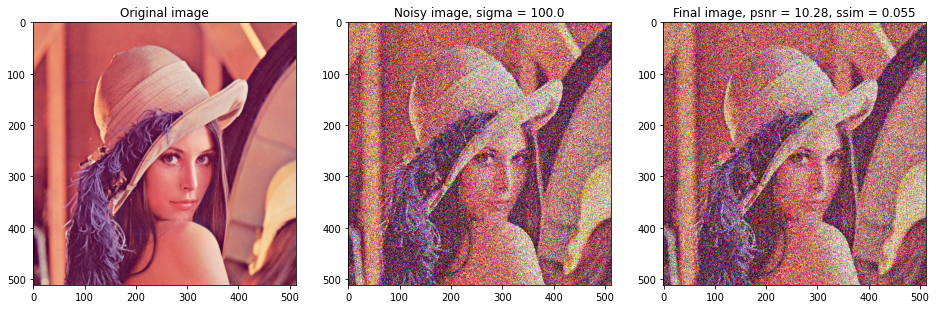

In [39]:
sigmas = np.linspace(10, 100, 10)
names = ["image_Lena512rgb.png", "4.1.05.tiff", "4.2.01.tiff", "4.2.03.tiff", "4.2.07.tiff"]

psnr_list = []
ssim_list = []

for sigma in sigmas:
    img_gold, noise_img, Final_img = fun(names[0], sigma=sigma)
    make_plot(img_gold, noise_img, Final_img, sigma)
    psnr_list.append(PSNR2(img_gold, Final_img))
    ssim_noise = ssim(img_gold, Final_img, data_range=Final_img.max()-img_gold.min(), multichannel=True)
    ssim_list.append(ssim_noise)
    #psnr_list.append(PSNR2(img_gold, cv2.cvtColor(Final_img, cv2.COLOR_YCrCb2BGR)))

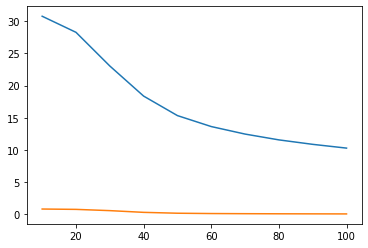

In [40]:
plt.plot(sigmas, psnr_list)
plt.plot(sigmas, ssim_list)
lists_psnr = []
ssim_list_comparison = []
lists_psnr.append(psnr_list)
ssim_list_comparison.append(ssim_list)

The Processing time of the NlMeansDenoising is 0.421679 s
The Processing time of the NlMeansDenoising is 0.407397 s
The Processing time of the NlMeansDenoising is 0.397393 s
The Processing time of the NlMeansDenoising is 0.472938 s
The Processing time of the NlMeansDenoising is 0.480361 s
The Processing time of the NlMeansDenoising is 0.484425 s
The Processing time of the NlMeansDenoising is 0.566233 s
The Processing time of the NlMeansDenoising is 0.568390 s
The Processing time of the NlMeansDenoising is 0.560221 s
The Processing time of the NlMeansDenoising is 0.650298 s


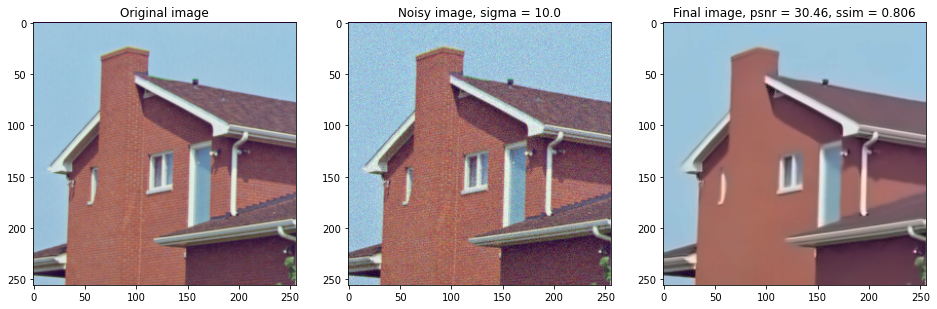

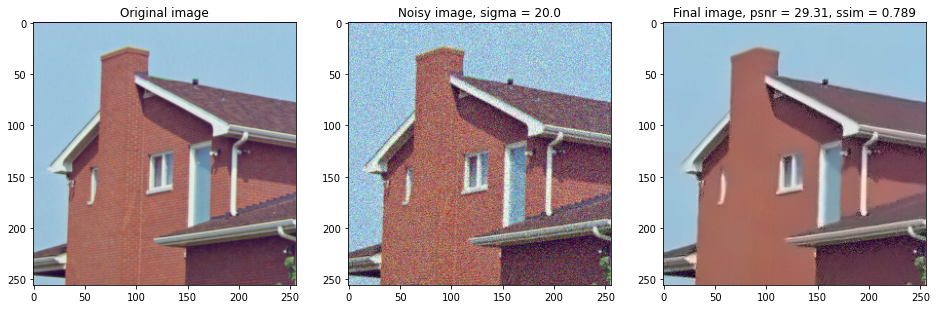

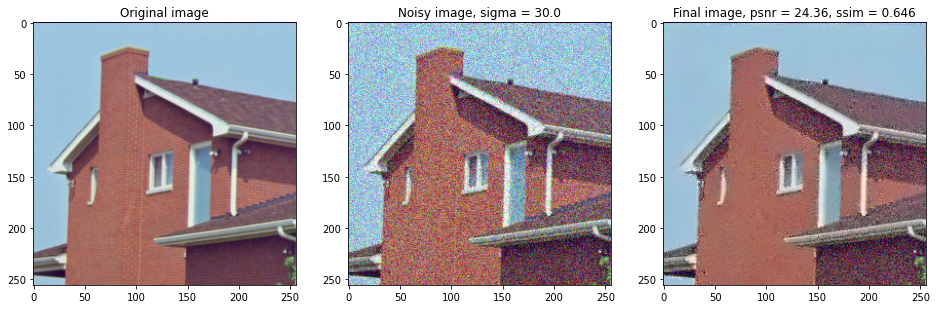

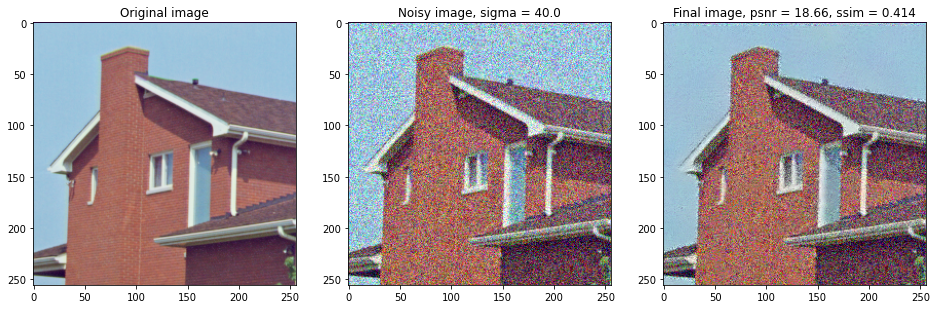

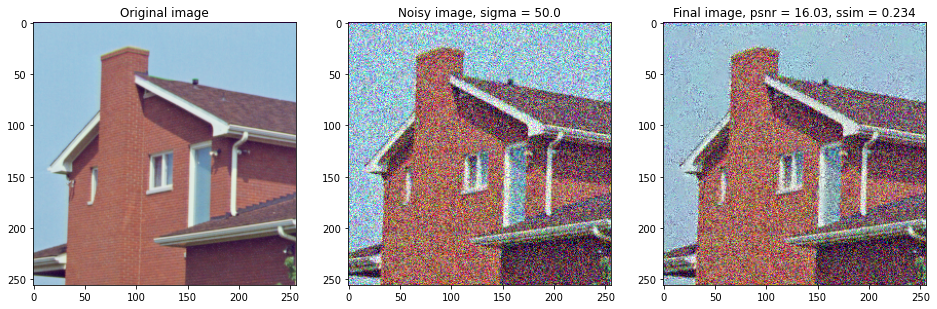

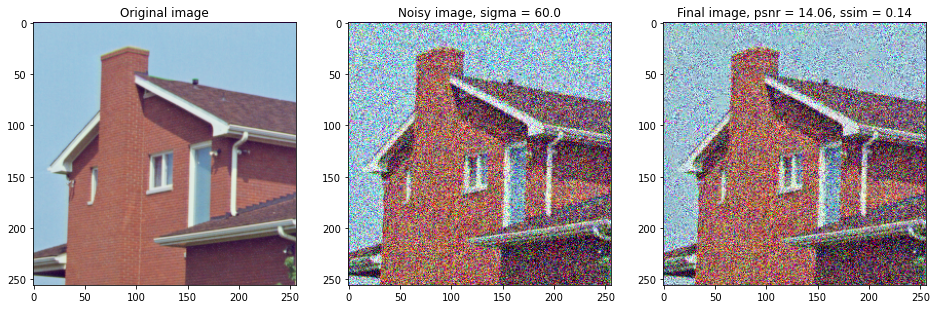

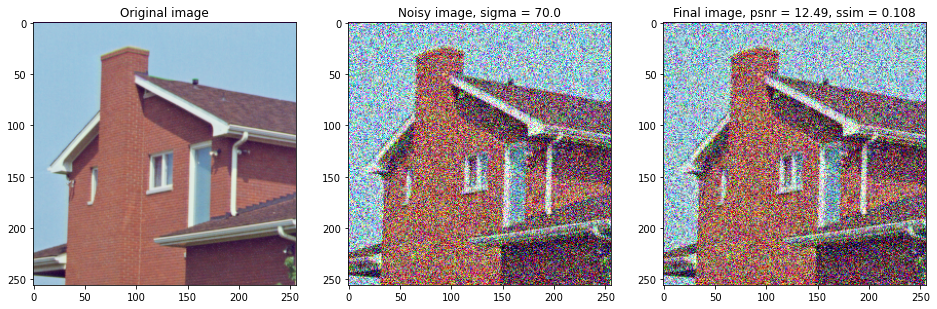

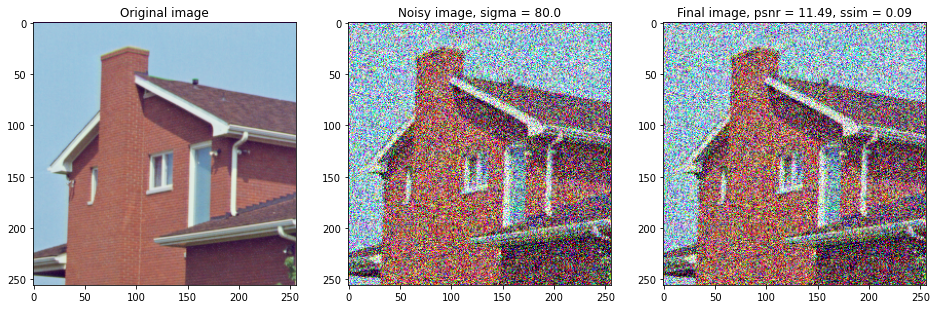

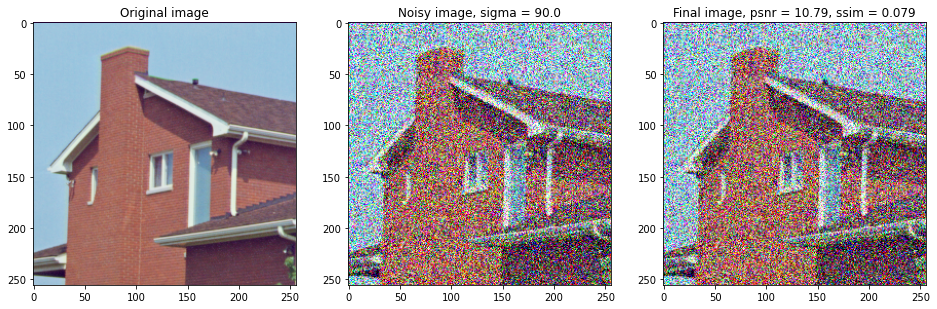

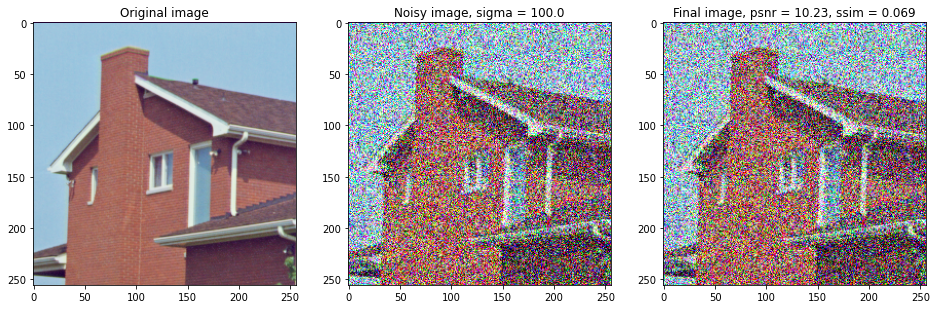

In [41]:
psnr_list = []
ssim_list = []

for sigma in sigmas:
    img_gold, noise_img, Final_img = fun(names[1], sigma=sigma)
    make_plot(img_gold, noise_img, Final_img, sigma)
    psnr_list.append(PSNR2(img_gold, Final_img))
    ssim_noise = ssim(img_gold, Final_img, data_range=Final_img.max()-img_gold.min(), multichannel=True)
    ssim_list.append(ssim_noise)

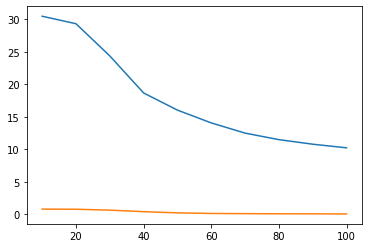

In [42]:
plt.plot(sigmas, psnr_list)
plt.plot(sigmas, ssim_list)
lists_psnr.append(psnr_list)
ssim_list_comparison.append(ssim_list)
psnr_list = []
ssim_list = []

In [ ]:
for sigma in sigmas:
    img_gold, noise_img, Final_img = fun(names[2], sigma=sigma)
    make_plot(img_gold, noise_img, Final_img, sigma)
    psnr_list.append(PSNR2(img_gold, Final_img))
    ssim_noise = ssim(img_gold, Final_img, data_range=Final_img.max()-img_gold.min(), multichannel=True)
    ssim_list.append(ssim_noise)

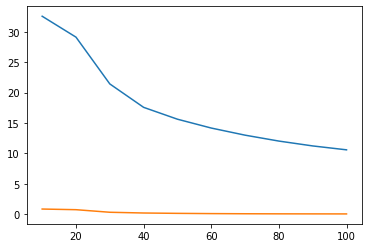

In [44]:
plt.plot(sigmas, psnr_list)
plt.plot(sigmas, ssim_list)
lists_psnr.append(psnr_list)
ssim_list_comparison.append(ssim_list)
psnr_list = []
ssim_list = []

In [ ]:
for sigma in sigmas:
    img_gold, noise_img, Final_img = fun(names[3], sigma=sigma)
    make_plot(img_gold, noise_img, Final_img, sigma)
    psnr_list.append(PSNR2(img_gold, Final_img))
    ssim_noise = ssim(img_gold, Final_img, data_range=Final_img.max()-img_gold.min(), multichannel=True)
    ssim_list.append(ssim_noise)

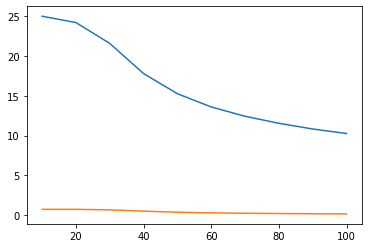

In [46]:
plt.plot(sigmas, psnr_list)
plt.plot(sigmas, ssim_list)
lists_psnr.append(psnr_list)
ssim_list_comparison.append(ssim_list)
psnr_list = []
ssim_list = []

The Processing time of the NlMeansDenoising is 1.217261 s
The Processing time of the NlMeansDenoising is 1.393132 s
The Processing time of the NlMeansDenoising is 1.384808 s
The Processing time of the NlMeansDenoising is 1.621367 s
The Processing time of the NlMeansDenoising is 1.628105 s
The Processing time of the NlMeansDenoising is 1.628754 s
The Processing time of the NlMeansDenoising is 1.896182 s
The Processing time of the NlMeansDenoising is 1.892671 s
The Processing time of the NlMeansDenoising is 1.894116 s
The Processing time of the NlMeansDenoising is 2.192913 s


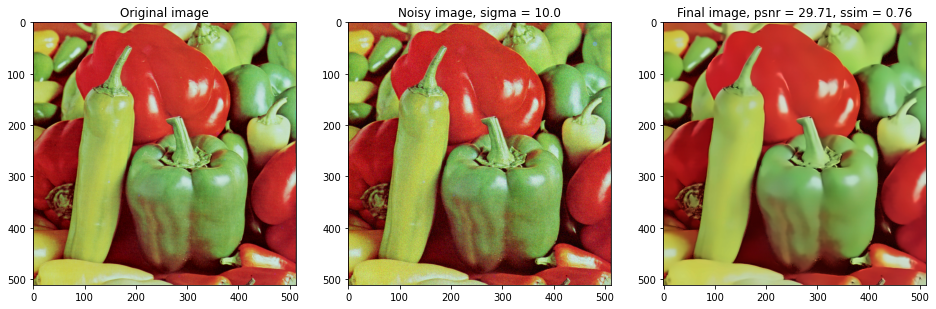

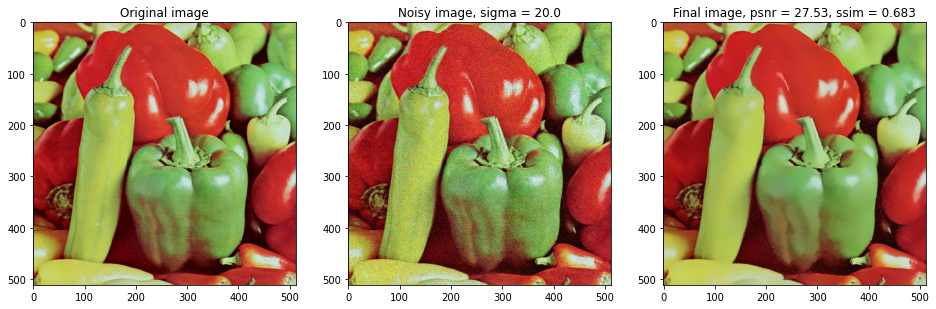

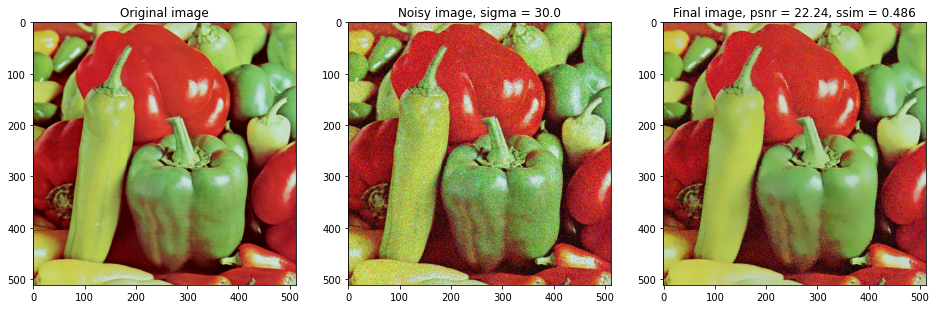

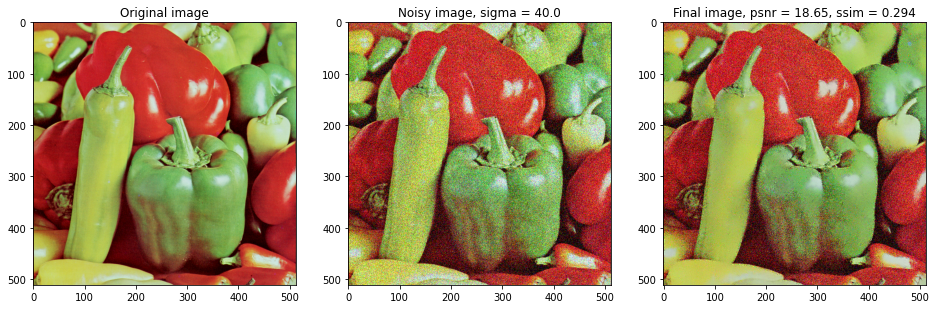

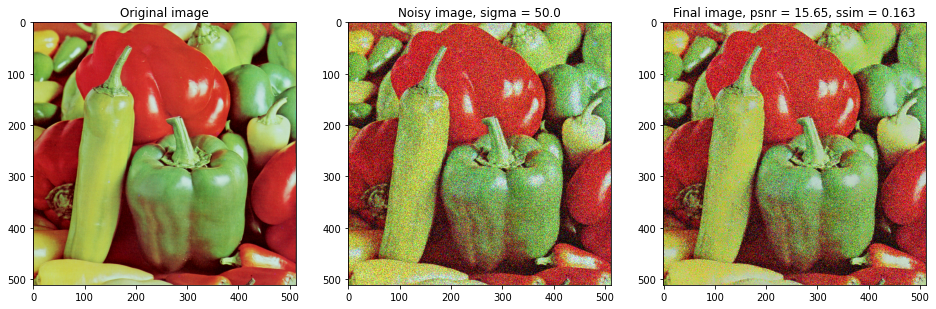

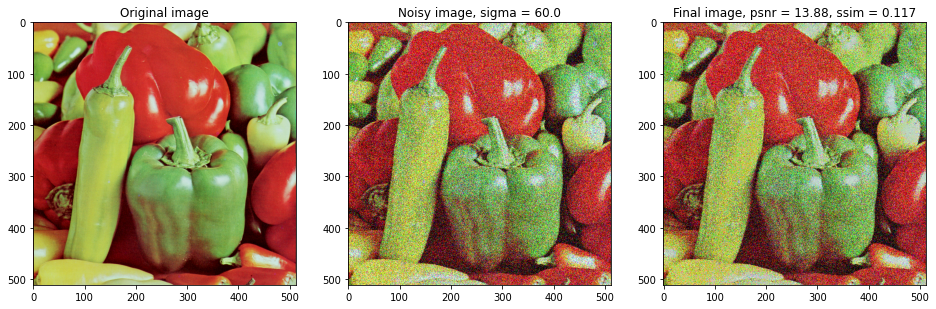

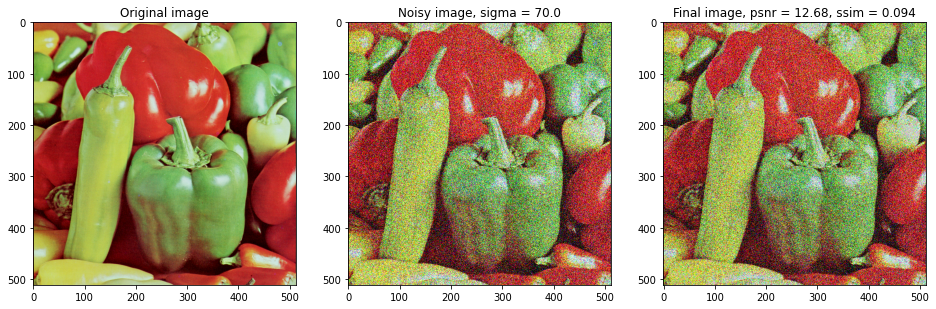

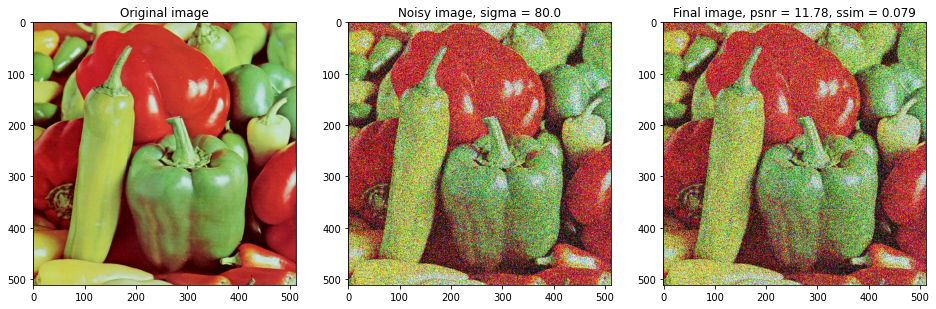

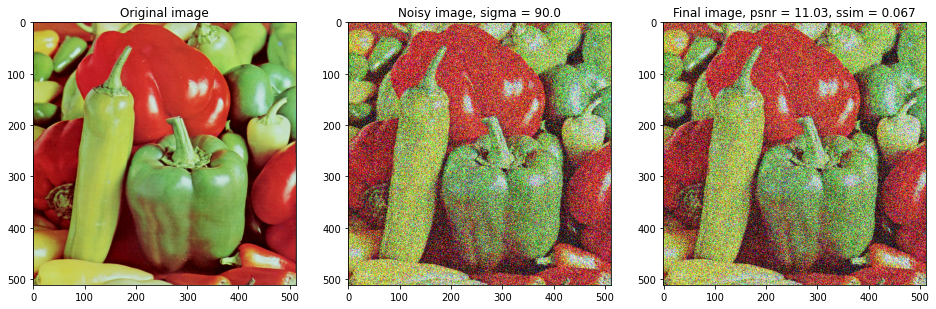

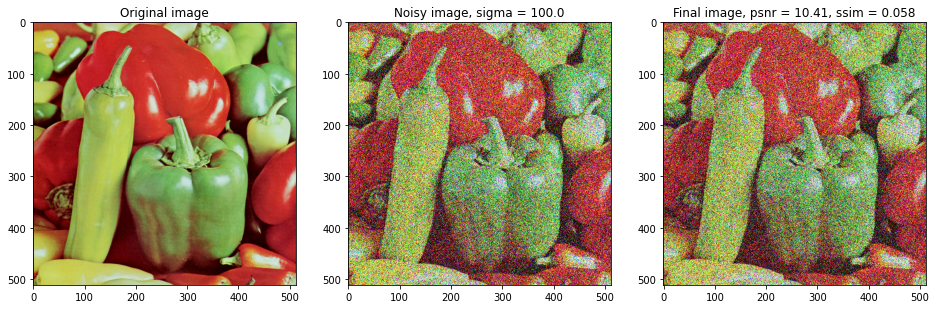

In [47]:
for sigma in sigmas:
    img_gold, noise_img, Final_img = fun(names[4], sigma=sigma)
    make_plot(img_gold, noise_img, Final_img, sigma)
    psnr_list.append(PSNR2(img_gold, Final_img))
    ssim_noise = ssim(img_gold, Final_img, data_range=Final_img.max()-img_gold.min(), multichannel=True)
    ssim_list.append(ssim_noise)

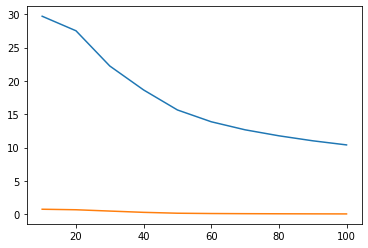

In [48]:
plt.plot(sigmas, psnr_list)
plt.plot(sigmas, ssim_list)
lists_psnr.append(psnr_list)
ssim_list_comparison.append(ssim_list)
psnr_list = []
ssim_list = []

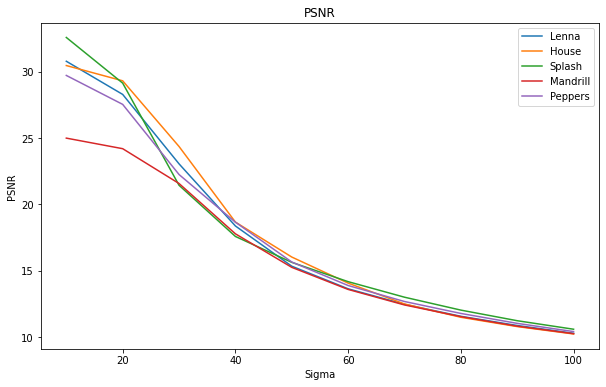

In [131]:
plt.figure(figsize=(10, 6))
for i in range(5):
    plt.plot(sigmas, lists_psnr[i])
plt.legend(['Lenna','House', 'Splash', 'Mandrill', 'Peppers'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('PSNR')
plt.title('PSNR')
plt.show()

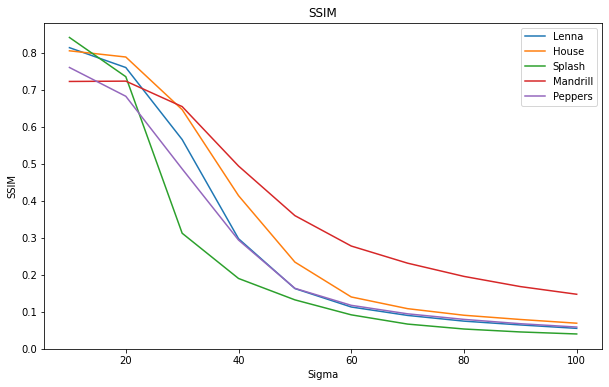

In [132]:
plt.figure(figsize=(10, 6))
for i in range(5):
    plt.plot(sigmas, ssim_list_comparison[i])
plt.legend(['Lenna','House', 'Splash', 'Mandrill', 'Peppers'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.title('SSIM')
plt.show()

In [99]:
tucker_house_psnr = [
31.86391216286394,
32.03696075707625,
30.94944102493773,
29.39492752306823,
26.766008535677237,
23.813791411848477,
21.773256122113352,
20.164505879065654,
18.50964677994282,
17.332162819876082]

tucker_house_ssim = [
0.9988335190796095,
0.9976030801926598,
0.9910995954722625,
0.9832483735634766,
0.9588133585752789,
0.9169042376255135,
0.8650823709611046,
0.8042535034967789,
0.7174058729622171,
0.6594058212695616]

In [100]:
tucker_splash_psnr = [
20.408694830114378,
19.456859996842596,
18.953572783655872,
18.25253857253612,
17.506824422201902,
16.74142621372415,
15.511313719762356,
14.650701866432357,
13.731126300137536,
12.910140077489027]

tucker_splash_ssim = [
0.9691956014880873,
0.9635422544404024,
0.953396156875192,
0.9300167621464596,
0.8844639954088604,
0.8214095237775498,
0.7399276750786804,
0.6551525017371095,
0.56973613371895,
0.5088704369049994]

In [111]:
tucker_mandrill_psnr = [
34.53181411842809,
32.405227462625405,
30.524284036039102,
28.930632020457672,
26.70351901823701,
24.66878672957062,
23.35634936798364,
21.84360227210626,
20.34904065512116,
19.100102164230574]

tucker_mandrill_ssim = [
0.9949188392825835,
0.9918189712116904,
0.986703937566276,
0.979584758795116,
0.966860858837447,
0.9459577873153631,
0.9237231239733776,
0.8893420069640738,
0.849139688852007,
0.7969551574755958]

In [102]:
tucker_peppers_psnr = [
13.350177541489447,
13.30558079632501,
13.217493662717722,
13.089726080353605,
12.91611480119343,
12.696013426220624,
12.408435267106563,
12.105209026314995,
11.775458975181678,
11.440097541209981]

tucker_peppers_ssim = [
0.3430472506222939,
0.33750527577912653,
0.3290709587760315,
0.3206412243765353,
0.30592582516225325,
0.28867269343549906,
0.26419780639249524,
0.24180274476511876,
0.21713719522636396,
0.19473828963151563]

In [135]:
bm3d_list_psnr = [[31.712073197646834,
  30.163704709598225,
  28.860831523364304,
  27.705597578759665,
  26.530017262033063,
  25.34482462584926,
  24.29977273644895,
  23.241609426800352,
  21.65691160752795,
  18.18626699731372],
 [32.04415926319313,
  30.44898382802433,
  29.09639570894134,
  27.923975610103305,
  26.632001518181823,
  25.31416170468915,
  23.80003546433599,
  22.8081942486071,
  20.851381643994067,
  18.382231200406146],
 [34.133365091325494,
  31.546094331709277,
  29.726674173300367,
  28.410277266692386,
  27.191052357756988,
  25.733206357597336,
  24.371158545747807,
  22.95989975925806,
  21.103667849920306,
  17.869700225196187],
 [25.271693484266976,
  23.11978317430605,
  21.599123987072637,
  20.380915592343456,
  19.797979459459174,
  19.511242852280226,
  19.31725669449023,
  19.012835108902323,
  18.100087032219772,
  16.77704064244075],
 [30.813781597098163,
  29.391649691852272,
  28.069490034116804,
  26.88268935614209,
  25.74534722302436,
  24.57827825509138,
  23.36721316335154,
  22.242603874844193,
  20.400889191983985,
  17.264341039442666]]

In [136]:
bm3d_list_ssim = [[0.8184229022394319,
  0.7842464210227263,
  0.7531160371568985,
  0.7258979904772139,
  0.6988934600453788,
  0.6713578020489148,
  0.6387825803198834,
  0.5706266488098687,
  0.5182748344235487,
  0.4357022660450433],
 [0.8162481860230416,
  0.7894003702490789,
  0.7675821848068644,
  0.7465708944599702,
  0.7270864002870643,
  0.7027593425657708,
  0.6598755529872217,
  0.5664606016593517,
  0.4922238837396842,
  0.4418445964572984],
 [0.843955087798378,
  0.8189029349972158,
  0.8008317806861669,
  0.7870375959394607,
  0.7726928463331677,
  0.7585579457180308,
  0.736631162055811,
  0.6744608532979068,
  0.5328702751488615,
  0.41018478613170634],
 [0.7540657742843916,
  0.6369768565337318,
  0.5251343207799052,
  0.405971850238317,
  0.34678465920134655,
  0.3284959918748387,
  0.3274661176610923,
  0.3115514682638751,
  0.28831680875126753,
  0.26466568733251644],
 [0.7684866053955565,
  0.7313486293797355,
  0.6987972402365147,
  0.6765017656264029,
  0.6462775710313856,
  0.6256959629636708,
  0.5947000334157417,
  0.5234519429759704,
  0.4406823683513119,
  0.3542335678891024]]

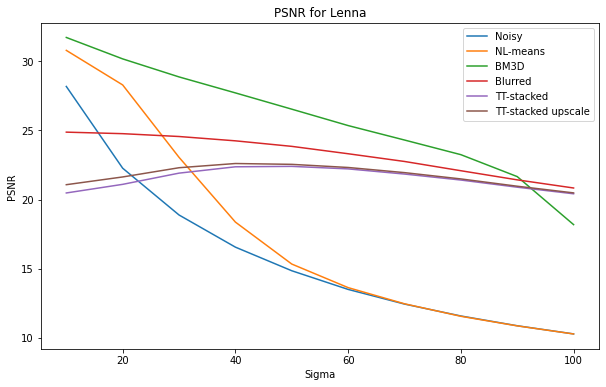

In [147]:
# Lenna

plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_lenna_psnr)
plt.plot(sigmas, lists_psnr[0])
plt.plot(sigmas, bm3d_list_psnr[0]) 
plt.plot(sigmas, noisy_blurred_lenna_psnr)
plt.plot(sigmas, TT_lenna_psnr)
plt.plot(sigmas, TT_upscale_lenna_psnr)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked', 'TT-stacked upscale'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('PSNR')
plt.title('PSNR for Lenna')
#plt.grid()
plt.show()

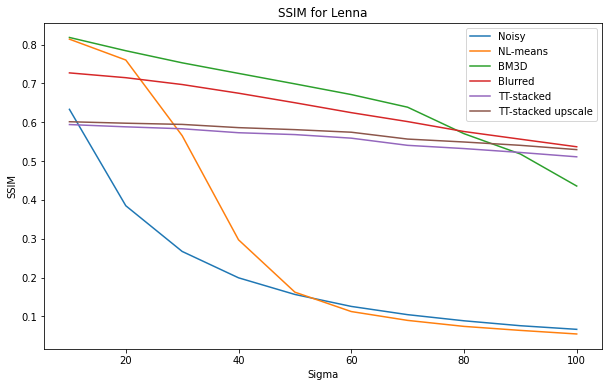

In [148]:
plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_lenna_ssim)
plt.plot(sigmas, ssim_list_comparison[0]) 
plt.plot(sigmas, bm3d_list_ssim[0]) 
plt.plot(sigmas, noisy_blurred_lenna_ssim)
plt.plot(sigmas, TT_lenna_ssim)
plt.plot(sigmas, TT_upscale_lenna_ssim)
plt.legend(['Noisy','NL-means', 'BM3D','Blurred', 'TT-stacked', 'TT-stacked upscale'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.title('SSIM for Lenna')
#plt.grid()
plt.show()

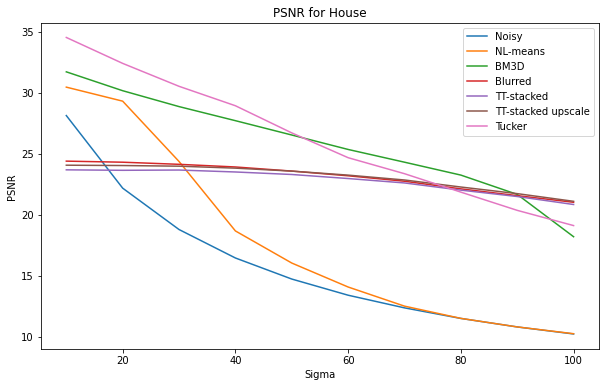

In [139]:
# House

plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_house_psnr)
plt.plot(sigmas, lists_psnr[1]) 
plt.plot(sigmas, bm3d_list_psnr[0]) 
plt.plot(sigmas, noisy_blurred_house_psnr)
plt.plot(sigmas, TT_house_psnr)
plt.plot(sigmas, TT_upscale_house_psnr)
plt.plot(sigmas, tucker_house_psnr)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('PSNR')
plt.title('PSNR for House')
#plt.grid()
plt.show()

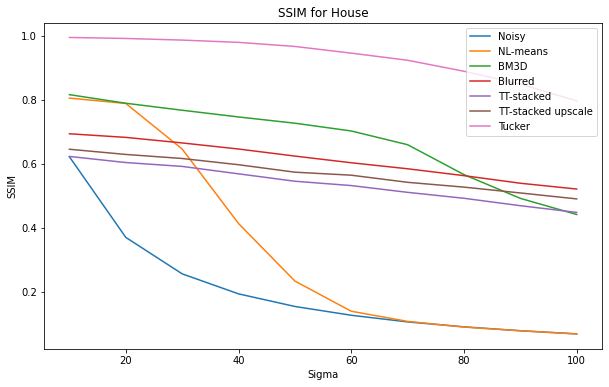

In [140]:
plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_house_ssim)
plt.plot(sigmas, ssim_list_comparison[1]) 
plt.plot(sigmas, bm3d_list_ssim[1]) 
plt.plot(sigmas, noisy_blurred_house_ssim)
plt.plot(sigmas, TT_house_ssim)
plt.plot(sigmas, TT_upscale_house_ssim)
plt.plot(sigmas, tucker_house_ssim)
plt.legend(['Noisy','NL-means','BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.title('SSIM for House')
#plt.grid()
plt.show()

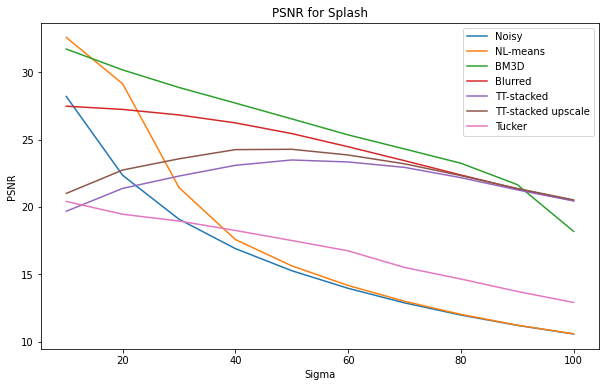

In [141]:
# Splash

plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_splash_psnr)
plt.plot(sigmas, lists_psnr[2]) 
plt.plot(sigmas, bm3d_list_psnr[0]) 
plt.plot(sigmas, noisy_blurred_splash_psnr)
plt.plot(sigmas, TT_splash_psnr)
plt.plot(sigmas, TT_upscale_splash_psnr)
plt.plot(sigmas, tucker_splash_psnr)
plt.legend(['Noisy','NL-means','BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('PSNR')
plt.title('PSNR for Splash')
#plt.grid()
plt.show()

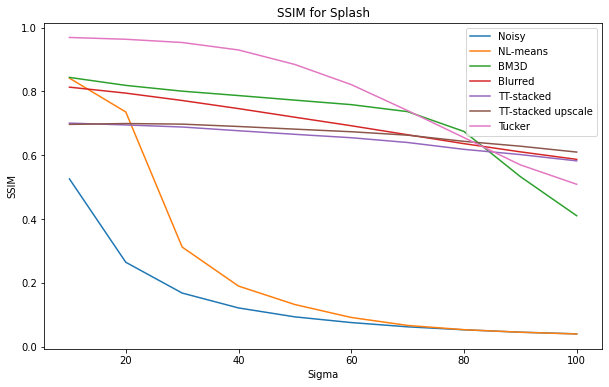

In [142]:
plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_splash_ssim)
plt.plot(sigmas, ssim_list_comparison[2]) 
plt.plot(sigmas, bm3d_list_ssim[2]) 
plt.plot(sigmas, noisy_blurred_splash_ssim)
plt.plot(sigmas, TT_splash_ssim)
plt.plot(sigmas, TT_upscale_splash_ssim)
plt.plot(sigmas, tucker_splash_ssim)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.title('SSIM for Splash')
#plt.grid()
plt.show()

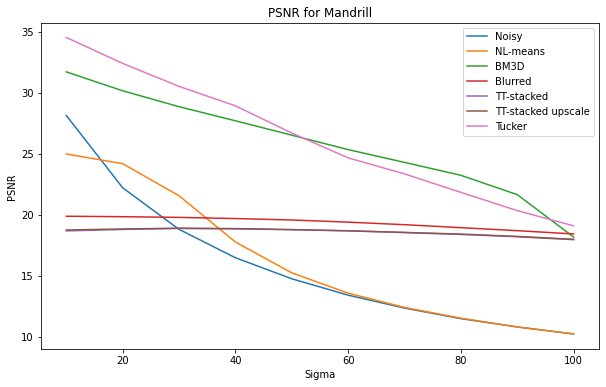

In [143]:
# Mandrill

plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_mandrill_psnr)
plt.plot(sigmas, lists_psnr[3]) 
plt.plot(sigmas, bm3d_list_psnr[0]) 
plt.plot(sigmas, noisy_blurred_mandrill_psnr)
plt.plot(sigmas, TT_mandrill_psnr)
plt.plot(sigmas, TT_upscale_mandrill_psnr)
plt.plot(sigmas, tucker_mandrill_psnr)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('PSNR')
plt.title('PSNR for Mandrill')
#plt.grid()
plt.show()

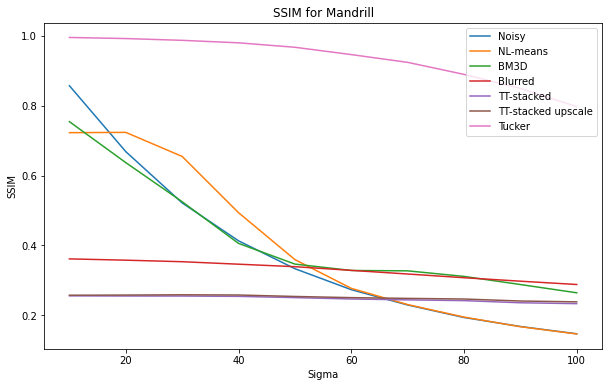

In [144]:
plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_mandrill_ssim)
plt.plot(sigmas, ssim_list_comparison[3]) 
plt.plot(sigmas, bm3d_list_ssim[3]) 
plt.plot(sigmas, noisy_blurred_mandrill_ssim)
plt.plot(sigmas, TT_mandrill_ssim)
plt.plot(sigmas, TT_upscale_mandrill_ssim)
plt.plot(sigmas, tucker_mandrill_ssim)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.title('SSIM for Mandrill')
#plt.grid()
plt.show()

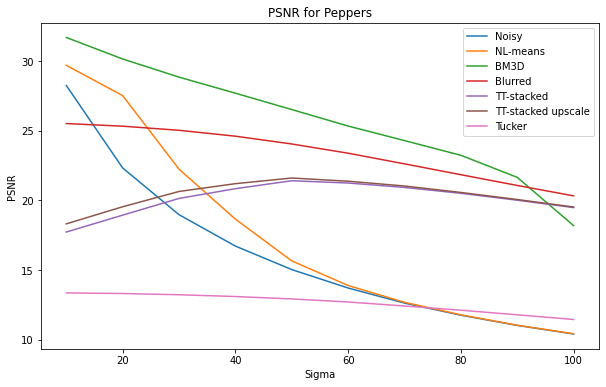

In [145]:
# Peppers

plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_peppers_psnr)
plt.plot(sigmas, lists_psnr[4]) 
plt.plot(sigmas, bm3d_list_psnr[0]) 
plt.plot(sigmas, noisy_blurred_peppers_psnr)
plt.plot(sigmas, TT_peppers_psnr)
plt.plot(sigmas, TT_upscale_peppers_psnr)
plt.plot(sigmas, tucker_peppers_psnr)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('PSNR')
plt.title('PSNR for Peppers')
#plt.grid()
plt.show()

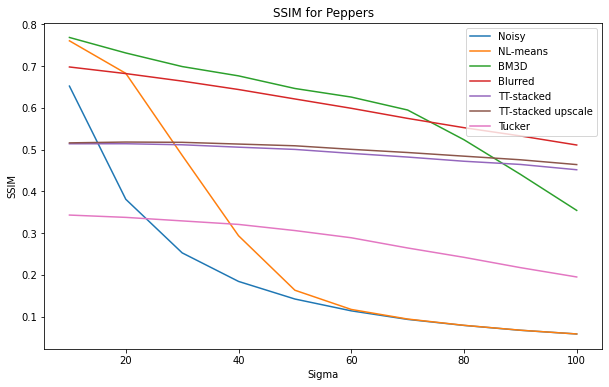

In [146]:
plt.figure(figsize=(10, 6))
plt.plot(sigmas, noisy_peppers_ssim)
plt.plot(sigmas, ssim_list_comparison[4]) 
plt.plot(sigmas, bm3d_list_ssim[4]) 
plt.plot(sigmas, noisy_blurred_peppers_ssim)
plt.plot(sigmas, TT_peppers_ssim)
plt.plot(sigmas, TT_upscale_peppers_ssim)
plt.plot(sigmas, tucker_peppers_ssim)
plt.legend(['Noisy','NL-means', 'BM3D', 'Blurred', 'TT-stacked',
            'TT-stacked upscale', 'Tucker'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.title('SSIM for Peppers')
#plt.grid()
plt.show()

In [57]:
import csv
import pandas as pd

df = pd.read_csv('metrics.csv') 

In [73]:
mask = ((df['method'] == 'noisy_blurred') & (df['image'] == 'House'))
noisy_blurred_house_psnr = list(df[mask].psnr)
noisy_blurred_house_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked') & (df['image'] == 'House'))
TT_house_psnr = list(df[mask].psnr)
TT_house_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked_upscale') & (df['image'] == 'House'))
TT_upscale_house_psnr = list(df[mask].psnr)
TT_upscale_house_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'noisy') & (df['image'] == 'House'))
noisy_house_psnr = list(df[mask].psnr)
noisy_house_ssim = list(df[mask].ssim)

In [74]:
mask = ((df['method'] == 'noisy_blurred') & (df['image'] == 'Lenna'))
noisy_blurred_lenna_psnr = list(df[mask].psnr)
noisy_blurred_lenna_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked') & (df['image'] == 'Lenna'))
TT_lenna_psnr = list(df[mask].psnr)
TT_lenna_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked_upscale') & (df['image'] == 'Lenna'))
TT_upscale_lenna_psnr = list(df[mask].psnr)
TT_upscale_lenna_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'noisy') & (df['image'] == 'Lenna'))
noisy_lenna_psnr = list(df[mask].psnr)
noisy_lenna_ssim = list(df[mask].ssim)

In [75]:
mask = ((df['method'] == 'noisy_blurred') & (df['image'] == 'Mandrill'))
noisy_blurred_mandrill_psnr = list(df[mask].psnr)
noisy_blurred_mandrill_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked') & (df['image'] == 'Mandrill'))
TT_mandrill_psnr = list(df[mask].psnr)
TT_mandrill_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked_upscale') & (df['image'] == 'Mandrill'))
TT_upscale_mandrill_psnr = list(df[mask].psnr)
TT_upscale_mandrill_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'noisy') & (df['image'] == 'Mandrill'))
noisy_mandrill_psnr = list(df[mask].psnr)
noisy_mandrill_ssim = list(df[mask].ssim)

In [76]:
mask = ((df['method'] == 'noisy_blurred') & (df['image'] == 'Peppers'))
noisy_blurred_peppers_psnr = list(df[mask].psnr)
noisy_blurred_peppers_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked') & (df['image'] == 'Peppers'))
TT_peppers_psnr = list(df[mask].psnr)
TT_peppers_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked_upscale') & (df['image'] == 'Peppers'))
TT_upscale_peppers_psnr = list(df[mask].psnr)
TT_upscale_peppers_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'noisy') & (df['image'] == 'Peppers'))
noisy_peppers_psnr = list(df[mask].psnr)
noisy_peppers_ssim = list(df[mask].ssim)

In [77]:
mask = ((df['method'] == 'noisy_blurred') & (df['image'] == 'Splash'))
noisy_blurred_splash_psnr = list(df[mask].psnr)
noisy_blurred_splash_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked') & (df['image'] == 'Splash'))
TT_splash_psnr = list(df[mask].psnr)
TT_splash_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'tensor_train_stacked_upscale') & (df['image'] == 'Splash'))
TT_upscale_splash_psnr = list(df[mask].psnr)
TT_upscale_splash_ssim = list(df[mask].ssim)

mask = ((df['method'] == 'noisy') & (df['image'] == 'Splash'))
noisy_splash_psnr = list(df[mask].psnr)
noisy_splash_ssim = list(df[mask].ssim)

In [ ]:
plt.figure(figsize=(10, 6))
for i in range(5):
    plt.plot(sigmas, ssim_list_comparison[i])
plt.legend(['Lenna','House', 'Splash', 'Monkey', 'Peppers'], loc='upper right')
plt.xlabel('Sigma')
plt.ylabel('SSIM')
plt.grid()
plt.show()